In [1]:
import numpy as np
import matplotlib.pyplot as plt
from snsphd import viz
import json
from pydantic import BaseModel, validator
import matplotlib

colors, swatches = viz.phd_style(jupyterStyle=True, grid=True, svg_mode=False)
viz.update_colors(dark=False)

# viz.bokeh_theme()

'done'

In [2]:
with open("../inter/old/PNR_hist_correction_data_24.json", "r") as f:
    data = json.load(f)

class PnrData(BaseModel):
    counts: np.ndarray
    corr1: np.ndarray
    corr2: np.ndarray
    bins: np.ndarray
    slices: np.ndarray

    @validator('counts', 'corr1', 'corr2', 'bins', 'slices', pre=True)
    def convert_to_numpy(cls, v):
        return np.array(v)
    
    class Config:
        arbitrary_types_allowed = True

pnr = PnrData(**data)

In [3]:
pnr.counts

array([[ -5.234375  , 553.765625  ],
       [  0.75390625, 553.75390625],
       [ 38.12304688, 636.12304688],
       ...,
       [-28.69921875, 515.30078125],
       [ 24.70703125, 579.70703125],
       [ 34.69140625, 591.69140625]])

In [4]:
x = []
y = []
hists = []

for i in range(10):
    x = pnr.counts[:,1] + i*50
    y = pnr.counts[:,0] + i*50
    hist = np.histogram2d(x, y, bins=pnr.bins)
    hists.append(hist[0])

In [12]:
from matplotlib import cm
import matplotlib as mpl
purd = mpl.colormaps['PuRd']
yign = mpl.colormaps['YlGn']
# Get a list of 256 colors from the colormap
purd = [purd(i) for i in range(256)][::-1]
yign = [yign(i) for i in range(256)][::-1]

# print(colors)

In [13]:

from numpy.random import standard_normal

from bokeh.plotting import figure, show, output_notebook
from bokeh.transform import linear_cmap
from bokeh.util.hex import hexbin
from bokeh.models import LogColorMapper
from bokeh.models import ColumnDataSource, Rect
from bokeh.palettes import Sunset8
from bokeh.colors import RGB
from bokeh.models import WheelZoomTool, PanTool

from IPython.display import clear_output

output_notebook()

alpha = np.linspace(0, 1, 256)
alpha = np.sqrt(alpha)
alpha = np.sqrt(alpha)
# for i, item in enumerate(purd):
#     item[3] = alpha[i]

# for i, item in enumerate(yign):
#     item[3] = alpha[i]

purd = [list(item[:3]) + [alpha[i]] for i, item in enumerate(purd)]
yign = [list(item[:3]) + [alpha[i]] for i, item in enumerate(yign)]

# RGB()

purd_alpha = [RGB(int(color[0]*255), int(color[1]*255), int(color[2]*255), color[3]) for color in purd]
purd_alpha[0] = RGB(purd[0][0], purd[0][1], purd[0][2], 0)
# print(purd_alpha)
# viridis_colors[1] = RGB(viridis.colors[1][0], viridis.colors[1][1], viridis.colors[1][2], 0)

yign_alpha = [RGB(int(color[0]*255), int(color[1]*255), int(color[2]*255), color[3]) for color in yign]
yign_alpha[0] = RGB(yign[0][0], yign[0][1], yign[0][2], 0)
# plasma_colors[1] = RGB(plasma.colors[1][0], plasma.colors[1][1], plasma.colors[1][2], 0)


def img_adj(img, x_start, x_end, y_start, y_end):
    img = img[x_start:x_end, y_start:y_end]
    img = np.flip(np.rot90(img), axis=0)
    img = img.astype(np.uint8)
    return img

def gaussian_2d(x, y, x0, y0, sigma_x, sigma_y):
    return np.exp(-((x-x0)**2/(2*sigma_x**2) + (y-y0)**2/(2*sigma_y**2)))


idx = 0

p = figure( match_aspect=True, background_fill_color='white', height=1000, tools=[WheelZoomTool(), PanTool()])


p.grid.visible = False

# img =  hists[idx][0] - 0.001
# img_2 = hists_50[idx][0]

imgs = hists
y_start = 500
y_end = 1700
x_start = 1300
x_end = 2500
# p.aspect_ratio = (x_start - x_end) / (y_start - y_end)


p.x_range.start = x_start
p.x_range.end = x_end
p.y_range.start = y_start
p.y_range.end = y_end


x_middle = (x_start + x_end) // 2
y_middle = (y_start + y_end) // 2


x, y = np.mgrid[x_start:x_end, y_start:y_end]
gauss = gaussian_2d(x, y, x_middle, y_middle, 100, 100)
levels = np.linspace(0, np.max(gauss), 9)
# print(levels)



# img = img_adj(img, x_start, x_end, y_start, y_end)
# img_2 = img_adj(img_2, x_start, x_end, y_start, y_end)

for i, im in enumerate(imgs):
    img = img_adj(im, x_start, x_end, y_start, y_end)
    imgs[i] = img
    

p.image(image=[imgs[0]], dh=y_end-y_start, dw=x_end-x_start, x=x_start, y=y_start, palette=purd_alpha)
p.image(image=[imgs[1]], dh=y_end-y_start, dw=x_end-x_start, x=x_start, y=y_start, palette=yign_alpha)
p.image(image=[imgs[2]], dh=y_end-y_start, dw=x_end-x_start, x=x_start, y=y_start, palette=purd_alpha)


source = ColumnDataSource(dict(x=[x_middle], y=[y_middle], w=[x_end-x_start], h=[y_end-y_start]))

glyph = Rect(x="x", y="y", width="w", height="h", angle=0, fill_color="#cab2d6", fill_alpha=0.1, line_color="black", line_alpha=0.5)

# contour_renderer = p.contour(x, y, gauss, levels, fill_color=Sunset8, line_color="black", fill_alpha=0.3)

p.add_glyph(source, glyph)

# Clear the previous output
# clear_output(wait=True)
_ = show(p)

Loading BokehJS ...

In [8]:
from matplotlib.patches import Ellipse

def draw_ellipse(position, covariance, ax=None, **kwargs):
    """Draw an ellipse with a given position and covariance"""
    ax = ax or plt.gca()
    
    # Convert covariance to principal axes
    if covariance.shape == (2, 2):
        U, s, Vt = np.linalg.svd(covariance)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(s)
    else:
        angle = 0
        width, height = 2 * np.sqrt(covariance)
    
    # Draw the Ellipse
    for nsig in np.linspace(0,4, 8):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle=angle, fill=False, edgecolor='red', alpha=0.3))
        
def plot_gmm(gmm, X, label=True, ax=None, data_alpha=0.2, **ellipse_kwargs):
    ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)
    if label:
        ax.scatter(X[:, 0], X[:, 1], c=labels, s=.01, cmap='viridis', zorder=2, alpha=data_alpha, rasterized=True)
    else:
        ax.scatter(X[:, 0], X[:, 1], s=.01, zorder=1, alpha=data_alpha, color='black', rasterized=True)
    ax.axis('equal')
    
    w_factor = 0.2 / gmm.weights_.max()
    for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
        draw_ellipse(pos, covar, alpha=w * w_factor, **ellipse_kwargs)




(-300.0, 200.0)

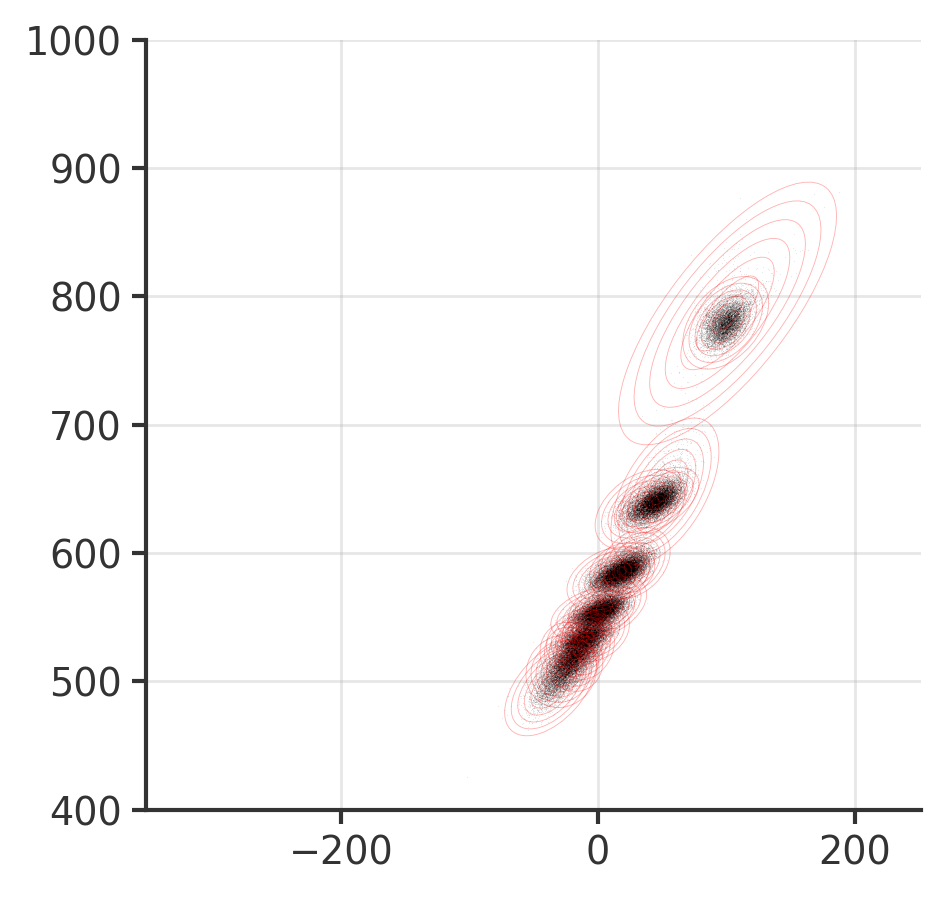

In [9]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=20, random_state=42) # .fit(pnr.counts)
# gm.means_

# labels = gm.predict(pnr.counts)

fig, ax = plt.subplots(1,1,figsize=(4,4))

# ax.scatter(pnr.counts[:, 0], pnr.counts[:, 1], s=.02, cmap='viridis')
# ax.scatter(pnr.counts[:, 0], pnr.counts[:, 1], c=labels, s=.02, cmap='viridis', alpha=0.2)

plot_gmm(gm, pnr.counts, data_alpha=0.1, edgecolor=[1,1,1,0.4], label=False)
ax.set_ylim(400,1000)
ax.set_xlim(-300,200)



In [10]:
import plotly

In [11]:
import plotly.graph_objects as go




def gaussian_2d(x, y, cov, pos=(0, 0)):
    """Generate a 2D Gaussian distribution with a given covariance matrix and position."""
    # Unpack the position tuple
    x0, y0 = pos

    # Shift the coordinates by x0 and y0
    x = x - x0
    y = y - y0

    # Calculate the inverse of the covariance matrix
    inv_cov = np.linalg.inv(cov)

    # Calculate the determinant of the covariance matrix
    det_cov = np.linalg.det(cov)

    # Calculate the exponent term of the Gaussian function
    exponent = -0.5 * (
        inv_cov[0, 0] * x**2
        + (inv_cov[0, 1] + inv_cov[1, 0]) * x * y
        + inv_cov[1, 1] * y**2
    )

    # Calculate the normalization constant of the Gaussian function
    norm_const = 1 / (2 * np.pi * np.sqrt(det_cov))

    # Calculate the Gaussian function values
    gauss = norm_const * np.exp(exponent)

    return gauss


def plot_gmm(
    gmm, X, label=True, ax=None, data_alpha=0.2, offsets=(50, 2), **ellipse_kwargs
):
    # ax = ax or plt.gca()
    labels = gmm.fit(X).predict(X)
    # if label:
    #     ax.scatter(X[:, 0], X[:, 1], c=labels, s=.04, cmap='viridis', zorder=2, alpha=data_alpha)
    # else:
    #     ax.scatter(X[:, 0], X[:, 1], s=1, zorder=.04, alpha=data_alpha, color='black')
    # ax.axis('equal')

    w_factor = 0.2 / gmm.weights_.max()

    y_range = (300, 1000)
    x_range = (-300, 200)

    x, y = np.meshgrid(
        np.arange(x_range[0], x_range[1], 2), np.arange(y_range[0], y_range[1], 2)
    )

    z = np.zeros(np.shape(x))
    # for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
    #     z = z + gaussian_2d(x, y, covar, pos) * w

    colors = ["Greens", "Oranges", "Blues", "Reds", "Blues", "Reds", "Blues"]

    fig = go.Figure()
    for i in range(offsets[1]):
        z = np.zeros(np.shape(x))
        for pos, covar, w in zip(gmm.means_, gmm.covariances_, gmm.weights_):
            z = (
                z
                + gaussian_2d(x, y, covar, [pos[0] + offsets[0]*i, pos[1] + offsets[0]*i]) * w
            )

        showscale = True if i == 0 else False  # set showscale to True for the first surface only

        z_max = np.max(z)
        z = z + z_max*.001*i
        # z = 1e6*z
        # z = z.astype(np.uint16)
        z = np.round(z, decimals=6)

        x = x.astype(np.int16)
        y = y.astype(np.int16)


        surf = go.Surface(
            colorscale=colors[i],
            contours={
                "x": {
                    "show": True,
                    "start": x_range[0],
                    "end": x_range[1],
                    "size": (x_range[1] - x_range[0]) / 40,
                    "color": "rgba(0,20,0,12)",
                },
                "y": {
                    "show": True,
                    "start": y_range[0],
                    "end": y_range[1],
                    "size": (y_range[1] - y_range[0]) / 40,
                    "color": "rgba(0,0,0,12)",
                },
                "z": {
                    "show": True,
                    "start": .000006,
                    "end": 0.001,
                    "size": 0.00006,
                    "color": "rgba(0,0,0,3)",
                },
            },
            x=x,
            y=y,
            z=z,
            showscale=showscale,
        )

        print(f"adding trace {i}")
        fig.add_trace(surf)

    fig.update_layout(
        # title="3d plot",
        autosize=True,
        width=1200,
        height=1000,
        scene_aspectmode="manual",
        scene_aspectratio=dict(x=1, y=1, z=0.2),
        scene=dict(
            xaxis=dict(
                showgrid=True,
                gridwidth=1,
                gridcolor="black",
            ),
            camera=dict(
                up=dict(x=0, y=0, z=1),
                center=dict(x=0, y=0, z=0),
                eye=dict(x=1, y=1, z=0.02),
            ),
        ),
    )

    line_marker = dict(color="#101010", width=4)
    fig.add_scatter3d(x=x, y=y, z=z + 0.03, mode="lines", line=line_marker, name="")

    fig.show()
    # fig.write_html("3_high_mfn.html")
    plotly.offline.plot(fig, filename="../www/3_high_mfn.html", auto_open=False)


plot_gmm(
    gm,
    pnr.counts,
    data_alpha=0.1,
    edgecolor=[0, 0, 0, 1],
    offsets=(-50, 4),
)



adding trace 0
adding trace 1
adding trace 2
adding trace 3
